<a href="https://colab.research.google.com/github/Mangesh1728/DeepVerify360-Guardian-of-Truth-in-Video-Realms/blob/main/deepfake_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive

# Mount Google Drive
drive.mount('/content/drive')


Mounted at /content/drive


Deep Fake Video Classification

Importing required libraries

In [ ]:
!pip install -U --upgrade tensorflow

In [ ]:
pip install tensorflow-docs

In [ ]:
from tensorflow_docs.vis import embed
from tensorflow import keras
#from imutils import paths
from tensorflow_docs.vis import embed

import matplotlib.pyplot as plt
import tensorflow as tf
import pandas as pd
import numpy as np
import imageio
import cv2
import os
from tensorflow.keras.layers import Bidirectional, LSTM, GlobalMaxPooling1D
from tensorflow.keras.preprocessing.image import ImageDataGenerator


Data Visualisation

In [ ]:
DATA_FOLDER = '/content/drive/MyDrive/deepfake'
TRAIN_SAMPLE_FOLDER = '/content/drive/MyDrive/deepfake/deep video/train_sample_videos'
TEST_FOLDER = '/content/drive/MyDrive/deepfake/deep video/test_videos'

print(f"Train samples: {len(os.listdir(os.path.join(DATA_FOLDER, TRAIN_SAMPLE_FOLDER)))}")
print(f"Test samples: {len(os.listdir(os.path.join(DATA_FOLDER, TEST_FOLDER)))}")

Train samples: 401
Test samples: 401


In [ ]:
train_sample_metadata = pd.read_json('/content/drive/MyDrive/deepfake/deep video/train_sample_videos/metadata.json').T
train_sample_metadata.head()

,label,split,original
aagfhgtpmv.mp4,FAKE,train,vudstovrck.mp4
aapnvogymq.mp4,FAKE,train,jdubbvfswz.mp4
abarnvbtwb.mp4,REAL,train,None
abofeumbvv.mp4,FAKE,train,atvmxvwyns.mp4
abqwwspghj.mp4,FAKE,train,qzimuostzz.mp4


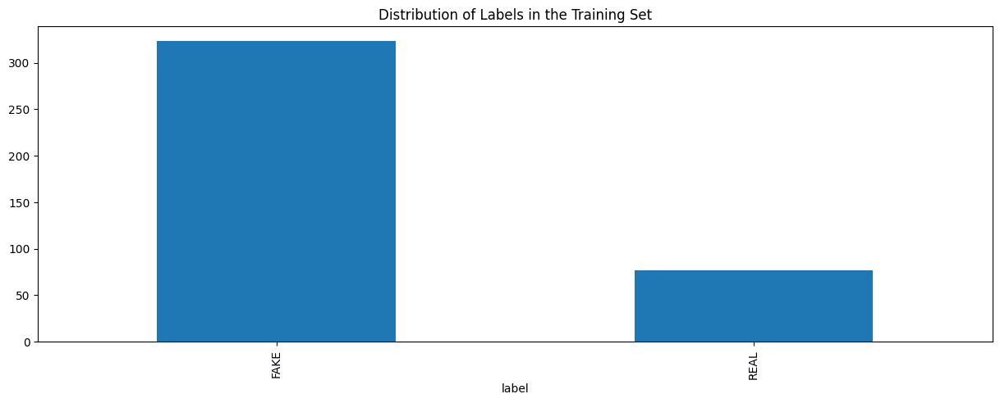

In [ ]:
train_sample_metadata.groupby('label')['label'].count().plot(figsize=(15, 5), kind='bar', title='Distribution of Labels in the Training Set')
plt.show()

In [ ]:
train_sample_metadata.shape

(400, 3)

Let's visualize now the data.

We select first a list of fake videos.

Few fake videos

In [ ]:
fake_train_sample_video = list(train_sample_metadata.loc[train_sample_metadata.label=='FAKE'].sample(3).index)
fake_train_sample_video

['acifjvzvpm.mp4', 'cbbibzcoih.mp4', 'dozyddhild.mp4']

In [ ]:
def display_image_from_video(video_path):
    '''
    input: video_path - path for video
    process:
    1. perform a video capture from the video
    2. read the image
    3. display the image
    '''
    capture_image = cv2.VideoCapture(video_path)
    ret, frame = capture_image.read()
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(111)
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    ax.imshow(frame)

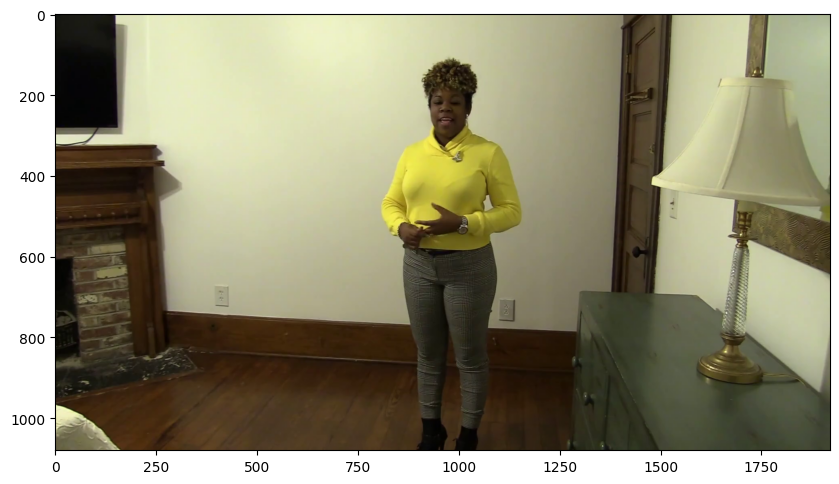

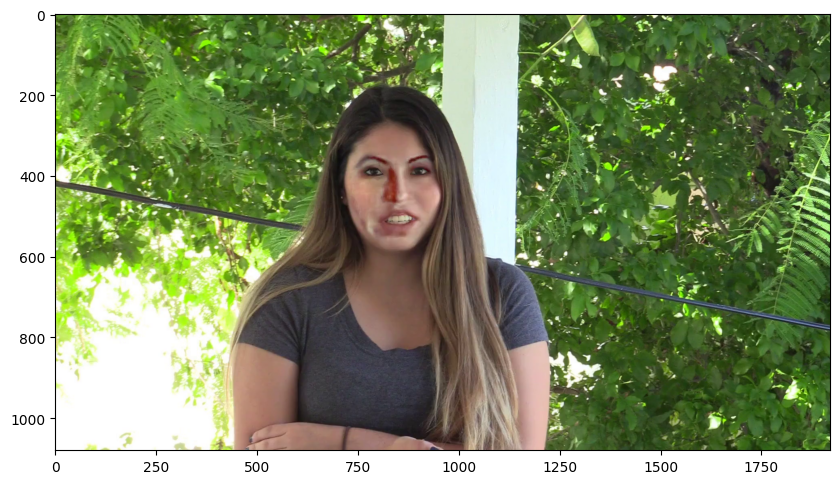

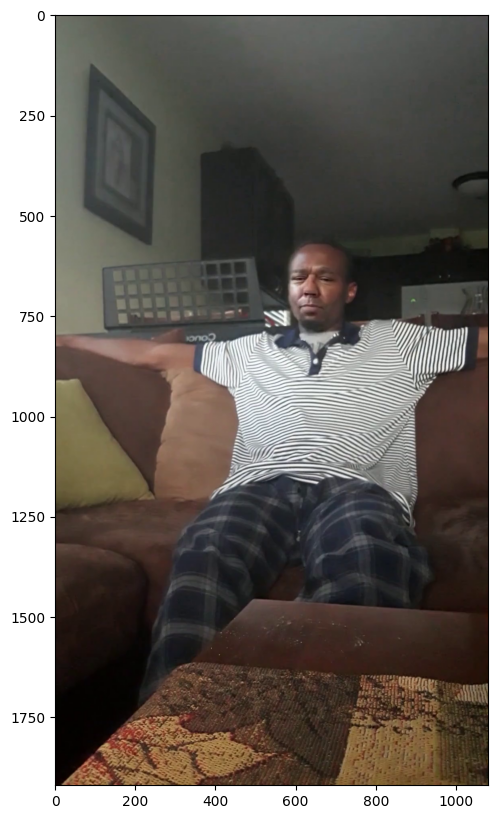

In [ ]:
for video_file in fake_train_sample_video:
    display_image_from_video(os.path.join(DATA_FOLDER, TRAIN_SAMPLE_FOLDER, video_file))

Let's try now the same for few of the images that are real.

In [ ]:
real_train_sample_video = list(train_sample_metadata.loc[train_sample_metadata.label=='REAL'].sample(3).index)
real_train_sample_video

['cobjrlugvp.mp4', 'ckjaibzfxa.mp4', 'clrycekyst.mp4']

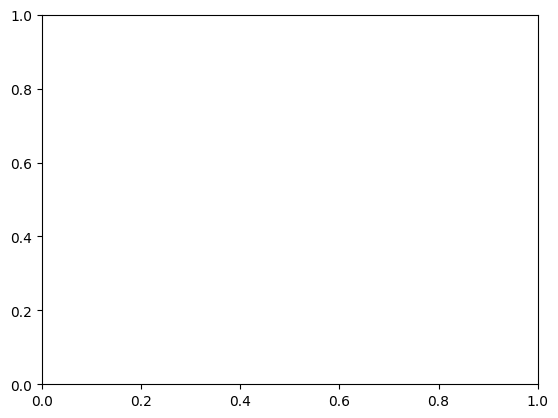

In [ ]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots()

In [ ]:
for video_file in real_train_sample_video:
    # Check if the video file exists
    if not os.path.exists(os.path.join(DATA_FOLDER, TRAIN_SAMPLE_FOLDER, video_file)):
        print(f"Invalid video file: {video_file}")
        continue

    # Read the video file and extract a frame
    video_path = os.path.join(DATA_FOLDER, TRAIN_SAMPLE_FOLDER, video_file)
    cap = cv2.VideoCapture(video_path)
    ret, frame = cap.read()
    cap.release()

    # Check if the frame is empty
    if frame is None:
        print(f"Empty frame in video file: {video_file}")
        continue

    # Convert the frame to RGB and display it
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    ax.imshow(frame)

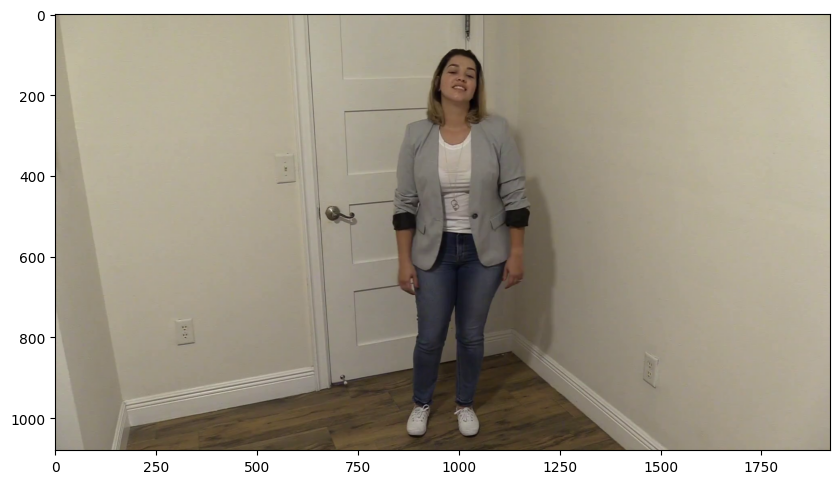

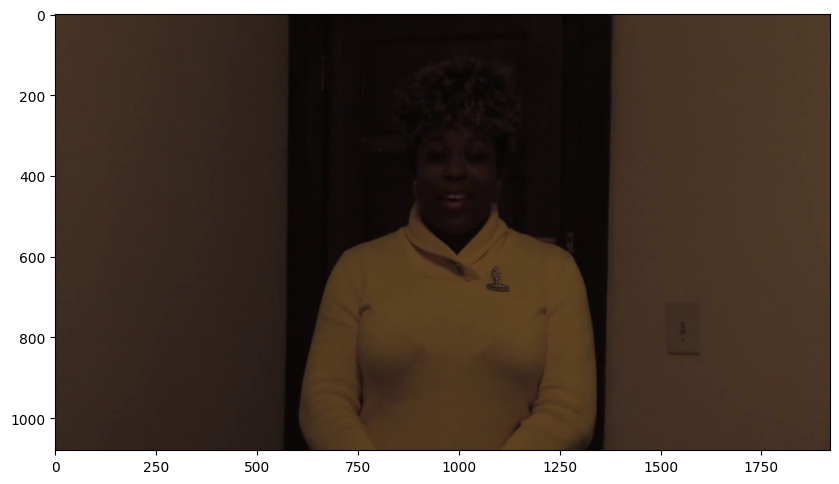

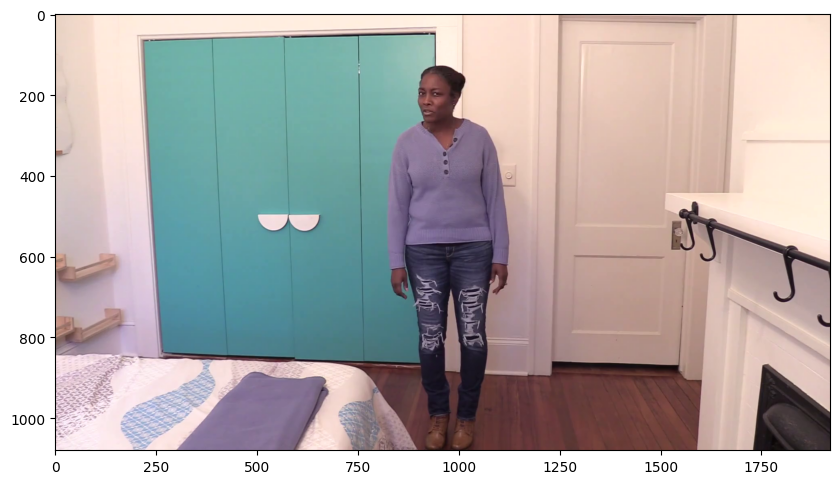

In [ ]:
for video_file in real_train_sample_video:
    display_image_from_video(os.path.join(DATA_FOLDER, TRAIN_SAMPLE_FOLDER, video_file))

Videos with same original

Let's look now to set of samples with the same original.

In [ ]:
train_sample_metadata['original'].value_counts()[0:5]

atvmxvwyns.mp4    6
meawmsgiti.mp4    6
qeumxirsme.mp4    5
kgbkktcjxf.mp4    5
fysyrqfguw.mp4    4
Name: original, dtype: int64

We pick one of the originals with largest number of samples.

We also modify our visualization function to work with multiple images.

In [ ]:
def display_image_from_video_list(video_path_list, video_folder=TRAIN_SAMPLE_FOLDER):
    '''
    input: video_path_list - path for video
    process:
    0. for each video in the video path list
        1. perform a video capture from the video
        2. read the image
        3. display the image
    '''
    plt.figure()
    fig, ax = plt.subplots(2,3,figsize=(16,8))
    # we only show images extracted from the first 6 videos
    for i, video_file in enumerate(video_path_list[0:6]):
        video_path = os.path.join(DATA_FOLDER, video_folder,video_file)
        capture_image = cv2.VideoCapture(video_path)
        ret, frame = capture_image.read()
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        ax[i//3, i%3].imshow(frame)
        ax[i//3, i%3].set_title(f"Video: {video_file}")
        ax[i//3, i%3].axis('on')

<Figure size 640x480 with 0 Axes>

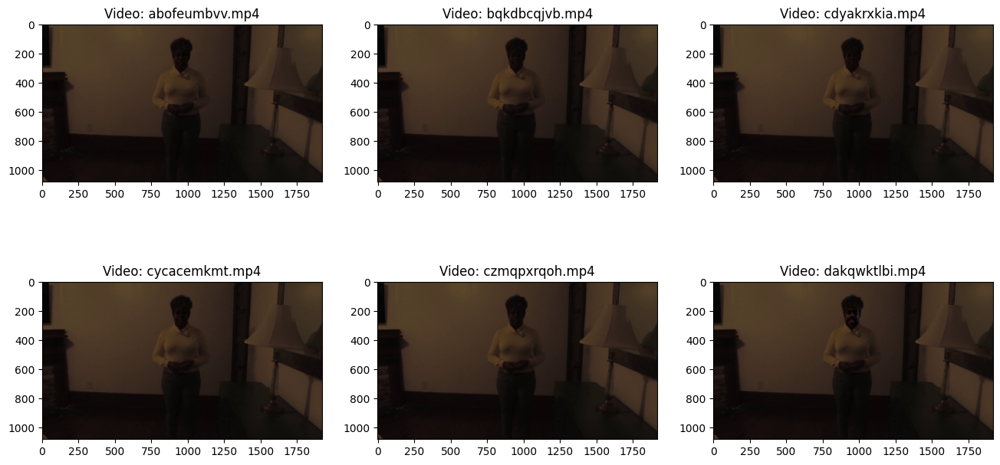

In [ ]:
same_original_fake_train_sample_video = list(train_sample_metadata.loc[train_sample_metadata.original=='atvmxvwyns.mp4'].index)
display_image_from_video_list(same_original_fake_train_sample_video)

Test video files

Let's also look to few of the test data files.

In [ ]:
test_videos = pd.DataFrame(list(os.listdir(os.path.join(DATA_FOLDER, TEST_FOLDER))), columns=['video'])

In [ ]:
test_videos.head()

,video
0,acazlolrpz.mp4
1,aassnaulhq.mp4
2,aayfryxljh.mp4
3,bdshuoldwx.mp4
4,apvzjkvnwn.mp4


Let's visualize now one of the videos.

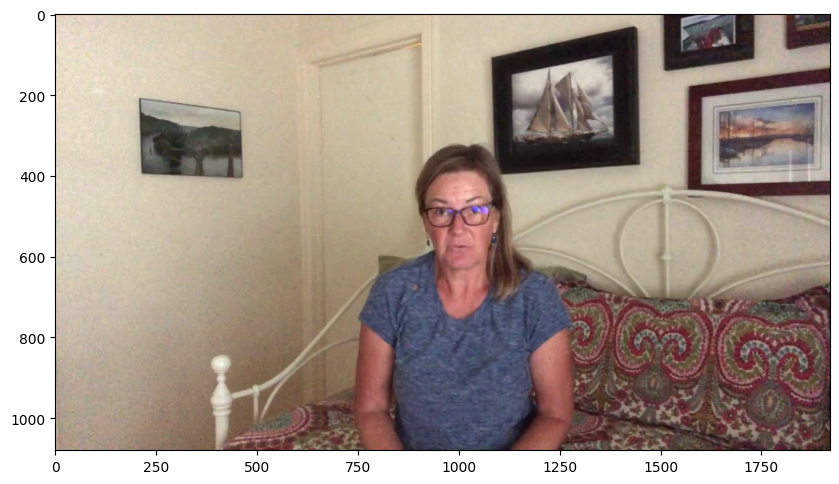

In [ ]:
display_image_from_video(os.path.join(DATA_FOLDER, TEST_FOLDER, test_videos.iloc[2].video))

Play video files

Let's look to few fake videos.

In [ ]:
fake_videos = list(train_sample_metadata.loc[train_sample_metadata.label=='FAKE'].index)

In [ ]:
from IPython.display import HTML
from base64 import b64encode

def play_video(video_file, subset=TRAIN_SAMPLE_FOLDER):
    '''
    Display video
    param: video_file - the name of the video file to display
    param: subset - the folder where the video file is located (can be TRAIN_SAMPLE_FOLDER or TEST_Folder)
    '''
    video_url = open(os.path.join(DATA_FOLDER, subset,video_file),'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(video_url).decode()
    return HTML("""<video width=500 controls><source src="%s" type="video/mp4"></video>""" % data_url)

play_video(fake_videos[10])

From visual inspection of these fakes videos, in some cases is very easy to spot the anomalies created when engineering the deep fake, in some cases is more difficult.

Modelling

A CNN-RNN Architecture

In [ ]:
IMG_SIZE = 224
BATCH_SIZE = 64
EPOCHS = 10

MAX_SEQ_LENGTH = 20
NUM_FEATURES = 2048

In this example we will do the following:

Capture the frames of a video.
Extract frames from the videos until a maximum frame count is reached.
In the case, where a video's frame count is lesser than the maximum frame count we will pad the video with zeros.

In [ ]:
def crop_center_square(frame):
    y, x = frame.shape[0:2]
    min_dim = min(y, x)
    start_x = (x // 2) - (min_dim // 2)
    start_y = (y // 2) - (min_dim // 2)
    return frame[start_y : start_y + min_dim, start_x : start_x + min_dim]


def load_video(path, max_frames=0, resize=(IMG_SIZE, IMG_SIZE)):
    cap = cv2.VideoCapture(path)
    frames = []
    try:
        while True:
            ret, frame = cap.read()
            if not ret:
                break
            frame = crop_center_square(frame)
            frame = cv2.resize(frame, resize)
            frame = frame[:, :, [2, 1, 0]]
            frames.append(frame)

            if len(frames) == max_frames:
                break
    finally:
        cap.release()
    return np.array(frames)

We can use a pre-trained network to extract meaningful features from the extracted frames. The Keras Applications module provides a number of state-of-the-art models pre-trained on the ImageNet-1k dataset. We will be using the InceptionV3 model for this purpose.

In [ ]:
def build_feature_extractor():
    feature_extractor = keras.applications.InceptionV3(
        weights="imagenet",
        include_top=False,
        pooling="avg",
        input_shape=(IMG_SIZE, IMG_SIZE, 3),
    )
    preprocess_input = keras.applications.inception_v3.preprocess_input

    inputs = keras.Input((IMG_SIZE, IMG_SIZE, 3))
    preprocessed = preprocess_input(inputs)

    outputs = feature_extractor(preprocessed)
    return keras.Model(inputs, outputs, name="feature_extractor")


feature_extractor = build_feature_extractor()

87910968/87910968 [==============================] - 1s 0us/step


Finally, we can put all the pieces together to create our data processing utility.

In [ ]:
def prepare_all_videos(df, root_dir):
    num_samples = len(df)
    video_paths = list(df.index)
    labels = df["label"].values
    labels = np.array(labels == 'FAKE').astype(int)


    # `frame_masks` and `frame_features` are what we will feed to our sequence model.
    # `frame_masks` will contain a bunch of booleans denoting if a timestep is
    # masked with padding or not.
    frame_masks = np.zeros(shape=(num_samples, MAX_SEQ_LENGTH), dtype="bool")
    frame_features = np.zeros(
        shape=(num_samples, MAX_SEQ_LENGTH, NUM_FEATURES), dtype="float32"
    )

    # For each video.
    for idx, path in enumerate(video_paths):
        # Gather all its frames and add a batch dimension.
        frames = load_video(os.path.join(root_dir, path))
        frames = frames[None, ...]

        # Initialize placeholders to store the masks and features of the current video.
        temp_frame_mask = np.zeros(shape=(1, MAX_SEQ_LENGTH,), dtype="bool")
        temp_frame_features = np.zeros(
            shape=(1, MAX_SEQ_LENGTH, NUM_FEATURES), dtype="float32"
        )

        # Extract features from the frames of the current video.
        for i, batch in enumerate(frames):
            video_length = batch.shape[0]
            length = min(MAX_SEQ_LENGTH, video_length)
            for j in range(length):
                temp_frame_features[i, j, :] = feature_extractor.predict(
                    batch[None, j, :]
                )
            temp_frame_mask[i, :length] = 1  # 1 = not masked, 0 = masked

        frame_features[idx,] = temp_frame_features.squeeze()
        frame_masks[idx,] = temp_frame_mask.squeeze()

    return (frame_features, frame_masks), labels

Since we don't have test labels we split the training data to find its performance in unseen data

In [ ]:
from sklearn.model_selection import train_test_split

Train_set, Test_set = train_test_split(train_sample_metadata,test_size=0.1,random_state=42,stratify=train_sample_metadata['label'])

print(Train_set.shape, Test_set.shape )

(360, 3) (40, 3)


In [ ]:
train_data, train_labels = prepare_all_videos(Train_set, "train")
test_data, test_labels = prepare_all_videos(Test_set, "test")

# Assuming train_data is a tuple with two elements: (frame_features, frame_masks)
frame_features_shape = train_data[0].shape if train_data and len(train_data) > 0 else None
frame_masks_shape = train_data[1].shape if train_data and len(train_data) > 1 else None

print(f"Frame features in train set: {frame_features_shape}")
print(f"Frame masks in train set: {frame_masks_shape}")

Frame features in train set: (360, 20, 2048)
Frame masks in train set: (360, 20)


**The sequence model**

Now, we can feed this data to a sequence model consisting of recurrent layers like GRU.

In [ ]:
frame_features_input = keras.Input((MAX_SEQ_LENGTH, NUM_FEATURES))
mask_input = keras.Input((MAX_SEQ_LENGTH,), dtype="bool")

# Refer to the following tutorial to understand the significance of using `mask`:
# https://keras.io/api/layers/recurrent_layers/gru/
x = keras.layers.GRU(16, return_sequences=True)(
    frame_features_input, mask=mask_input
)
x = keras.layers.GRU(8)(x)
x = keras.layers.Dropout(0.4)(x)
x = keras.layers.Dense(8, activation="relu")(x)
output = keras.layers.Dense(1, activation="sigmoid")(x)

model = keras.Model([frame_features_input, mask_input], output)

model.compile(loss="binary_crossentropy", optimizer="adam", metrics=["accuracy"])
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, 20, 2048)]           0         []                            
                                                                                                  
 input_4 (InputLayer)        [(None, 20)]                 0         []                            
                                                                                                  
 gru (GRU)                   (None, 20, 16)               99168     ['input_3[0][0]',             
                                                                     'input_4[0][0]']             
                                                                                                  
 gru_1 (GRU)                 (None, 8)                    624       ['gru[0][0]']             

Epoch 1/10
6/6 [==============================] - 15s 595ms/step - loss: 0.6924 - accuracy: 0.6972 - val_loss: 0.6914 - val_accuracy: 0.8000
Epoch 2/10
6/6 [==============================] - 1s 105ms/step - loss: 0.6905 - accuracy: 0.8083 - val_loss: 0.6896 - val_accuracy: 0.8000
Epoch 3/10
6/6 [==============================] - 1s 205ms/step - loss: 0.6888 - accuracy: 0.8083 - val_loss: 0.6878 - val_accuracy: 0.8000
Epoch 4/10
6/6 [==============================] - 1s 203ms/step - loss: 0.6870 - accuracy: 0.8083 - val_loss: 0.6861 - val_accuracy: 0.8000
Epoch 5/10
6/6 [==============================] - 1s 128ms/step - loss: 0.6852 - accuracy: 0.8083 - val_loss: 0.6844 - val_accuracy: 0.8000
Epoch 6/10
6/6 [==============================] - 1s 102ms/step - loss: 0.6834 - accuracy: 0.8083 - val_loss: 0.6827 - val_accuracy: 0.8000
Epoch 7/10
6/6 [==============================] - 1s 92ms/step - loss: 0.6817 - accuracy: 0.8083 - val_loss: 0.6809 - val_accuracy: 0.8000
Epoch 8/10
6/6 [====

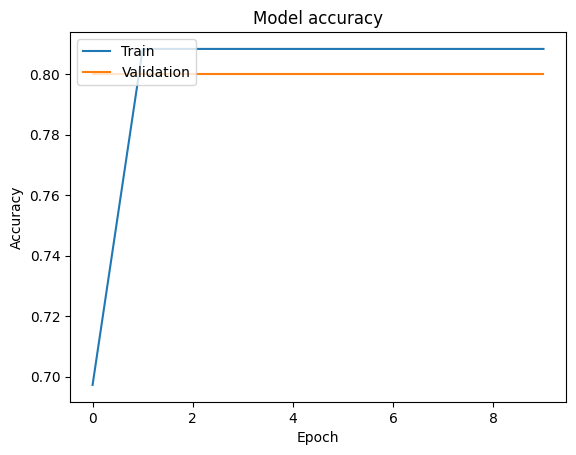

Test accuracy: 0.8000


In [ ]:
#accuracy of the model

import matplotlib.pyplot as plt
history = model.fit(
    train_data, train_labels, epochs=EPOCHS, batch_size=BATCH_SIZE, validation_data=(test_data, test_labels)
)
plt.plot(history.history["accuracy"])
plt.plot(history.history["val_accuracy"])
plt.title("Model accuracy")
plt.ylabel("Accuracy")
plt.xlabel("Epoch")
plt.legend(["Train", "Validation"], loc="upper left")
plt.show()
print(f"Test accuracy: {history.history['val_accuracy'][-1]:.4f}")

In [ ]:
pip install --upgrade tensorflow

 **Inference**

In [ ]:
def prepare_single_video(frames):
    frames = frames[None, ...]
    frame_mask = np.zeros(shape=(1, MAX_SEQ_LENGTH,), dtype="bool")
    frame_features = np.zeros(shape=(1, MAX_SEQ_LENGTH, NUM_FEATURES), dtype="float32")

    for i, batch in enumerate(frames):
        video_length = batch.shape[0]
        length = min(MAX_SEQ_LENGTH, video_length)
        for j in range(length):
            frame_features[i, j, :] = feature_extractor.predict(batch[None, j, :])
        frame_mask[i, :length] = 1  # 1 = not masked, 0 = masked

    return frame_features, frame_mask

def sequence_prediction(path):
    frames = load_video(os.path.join(DATA_FOLDER, TEST_FOLDER,path))
    frame_features, frame_mask = prepare_single_video(frames)
    return model.predict([frame_features, frame_mask])[0]


def to_gif(images):
    converted_images = images.astype(np.uint8)
    imageio.mimsave("animation.gif", converted_images, fps=10)
    return embed.embed_file("animation.gif")


test_video = input("Enter the path of the video: ")
print(f"Test video path: {test_video}")

if(sequence_prediction(test_video)>=0.5):
    print(f'The predicted class of the video is FAKE')
else:
    print(f'The predicted class of the video is REAL')

play_video(test_video,TEST_FOLDER)


Enter the path of the video: /content/drive/MyDrive/deepfake/deep video/test_videos/fake.mp4
Test video path: /content/drive/MyDrive/deepfake/deep video/test_videos/fake.mp4
1/1 [==============================] - 3s 3s/step
The predicted class of the video is FAKE


In [ ]:
import os
import numpy as np
import imageio
import matplotlib.pyplot as plt  # Make sure you have matplotlib installed
from tensorflow.keras.models import load_model

# Assuming you have defined MAX_SEQ_LENGTH, NUM_FEATURES, DATA_FOLDER, TEST_FOLDER, and feature_extractor

# Function to load a video and return a specific number of frames (e.g., 10 frames)
def load_video(video_path, num_frames=10):
    reader = imageio.get_reader(video_path)
    frames = []
    try:
        for i in range(num_frames):
            frame = reader.get_next_data()
            frames.append(frame)
    except IndexError:
        pass
    return np.array(frames)

def prepare_single_video(frames):
    frames = frames[None, ...]
    frame_mask = np.zeros(shape=(1, MAX_SEQ_LENGTH,), dtype="bool")
    frame_features = np.zeros(shape=(1, MAX_SEQ_LENGTH, NUM_FEATURES), dtype="float32")

    for i, batch in enumerate(frames):
        video_length = batch.shape[0]
        length = min(MAX_SEQ_LENGTH, video_length)
        for j in range(length):
            frame_features[i, j, :] = feature_extractor.predict(batch[None, j, :])
        frame_mask[i, :length] = 1  # 1 = not masked, 0 = masked

    return frame_features, frame_mask

def sequence_prediction(frames):
    frame_features, frame_mask = prepare_single_video(frames)
    return model.predict([frame_features, frame_mask])[0]

def visualize_frames_with_predictions(video_path):
    frames = load_video(os.path.join(DATA_FOLDER, TEST_FOLDER, video_path), num_frames=10)

    prediction = sequence_prediction(frames)

    # Print or save the prediction for the entire sequence
    print(f"Video: {video_path}, {'FAKE' if prediction >= 0.5 else 'REAL'}")

# Input the path of the video
test_video = input("Enter the path of the video: ")
print(f"Test video path: {test_video}")

# Visualize frames with predictions
visualize_frames_with_predictions(test_video)


Enter the path of the video: /content/drive/MyDrive/deepfake/deep video/test_videos/fake.mp4
Test video path: /content/drive/MyDrive/deepfake/deep video/test_videos/fake.mp4
1/1 [==============================] - 0s 44ms/step
Video: /content/drive/MyDrive/deepfake/deep video/test_videos/fake.mp4, FAKE


In [ ]:
history = model.fit(
    train_data,  # Features (input data)
    train_labels,  # Labels (target data)
    epochs=EPOCHS,  # Number of epochs (iterations over the entire dataset)
    batch_size=BATCH_SIZE,  # Batch size (number of samples per gradient update)
    validation_data=(test_data, test_labels)  # Optional: validation data to evaluate the model
)


Epoch 1/10
6/6 [==============================] - 2s 302ms/step - loss: 0.6767 - accuracy: 0.8083 - val_loss: 0.6762 - val_accuracy: 0.8000
Epoch 2/10
6/6 [==============================] - 1s 208ms/step - loss: 0.6752 - accuracy: 0.8083 - val_loss: 0.6748 - val_accuracy: 0.8000
Epoch 3/10
6/6 [==============================] - 1s 188ms/step - loss: 0.6737 - accuracy: 0.8083 - val_loss: 0.6734 - val_accuracy: 0.8000
Epoch 4/10
6/6 [==============================] - 1s 99ms/step - loss: 0.6722 - accuracy: 0.8083 - val_loss: 0.6719 - val_accuracy: 0.8000
Epoch 5/10
6/6 [==============================] - 1s 98ms/step - loss: 0.6707 - accuracy: 0.8083 - val_loss: 0.6705 - val_accuracy: 0.8000
Epoch 6/10
6/6 [==============================] - 1s 98ms/step - loss: 0.6693 - accuracy: 0.8083 - val_loss: 0.6691 - val_accuracy: 0.8000
Epoch 7/10
6/6 [==============================] - 1s 103ms/step - loss: 0.6678 - accuracy: 0.8083 - val_loss: 0.6677 - val_accuracy: 0.8000
Epoch 8/10
6/6 [=======

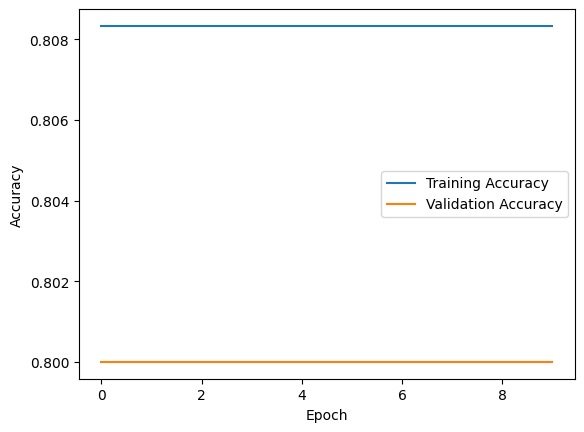

In [ ]:
import matplotlib.pyplot as plt

# Plot training and validation accuracy
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()


In [ ]:
model.save("/content/drive/MyDrive/deepfake/deepfake_model.h5")

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
pip install streamlit


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.4/8.4 MB 27.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 195.4/195.4 kB 26.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.8/4.8 MB 65.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.0/83.0 kB 12.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 9.3 MB/s eta 0:00:00
ERROR: Operation cancelled by user


In [ ]:
! pip install streamlit -q

In [ ]:
!wget -q -O - ipv4.icanhazip.com

35.203.155.41


In [ ]:
! streamlit run deepfake_app.py & npx localtunnel --port 8501

[..................] \ fetchMetadata: sill resolveWithNewModule localtunnel@2.0


  You can now view your Streamlit app in your browser.

  Network URL: http://172.28.0.12:8501
  External URL: http://35.203.155.41:8501

npx: installed 22 in 2.39s
your url is: https://five-lights-dress.loca.lt
2024-02-07 16:38:44.473026: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-02-07 16:38:44.473075: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-02-07 16:38:44.474479: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-02-07 16:38:44.482412: I tensorflow/core/platform/cpu_feature_guar